# Folder navigation

In [1]:
import os
import re
from pathlib import Path

In [2]:
def build_file_list_from_path(path=Path('..')):
    empty_list = []
    
    # Build a list of every file directory in the given folder
    for root, dirs, files in os.walk(path.resolve()):
        print(root)
        # Filter out directories that contain unimportant or hidden files
        dirs[:] = [d for d in dirs if not d[0] == '.']
        dirs[:] = [d for d in dirs if not d[0] == '_']
        
        # use files and dirs
        for directory in dirs:
            print(f"\n\nSaving files in: {root}/{directory}")
            directory = Path(f"{root}/{directory}")
            
            for file_var in os.listdir(directory):
                root_dir = Path(f"{root}")
                print(f"Saving: {Path(root/directory/file_var)}")
                
                empty_list.append(f"{Path(root/directory/file_var)}")
    
    return empty_list

In [3]:
list_of_files = build_file_list_from_path()

C:\Users\drpar\PycharmProjects\civilpy


Saving files in: C:\Users\drpar\PycharmProjects\civilpy/civilpy
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\CLI.py
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\construction
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\environmental
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\general
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\geotechnical
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\state
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\structural
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\transportation
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\water_resources
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\webpages
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\__init__.py
Saving: C:\Users\drpar\PycharmProjects\civilpy\civilpy\__pycache__


Saving files in: C:\Users\drpar\PycharmProjects\civilpy/docs
Saving: C:\Users\drpar\PycharmProjec

In [4]:
from pprint import pprint

for file in list_of_files:
    pprint(str(file))

'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\CLI.py'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\construction'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\environmental'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\general'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\geotechnical'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\state'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\structural'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\transportation'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\water_resources'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\webpages'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\__init__.py'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\civilpy\\__pycache__'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\docs\\civilpy.construction.rst'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\docs\\civilpy.environmental.rst'
'C:\\Users\\drpar\\PycharmProjects\\civilpy\\docs

### Filter list of files for certain file types

In [5]:
photos = [ fi for fi in list_of_files if re.search("(svg|heif|bmp|tiff|webp|jpeg|png|jpg)$", str(fi), re.IGNORECASE)]

In [6]:
photos

['C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_1.JPG',
 'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_2.JPG',
 'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_3.JPG',
 'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_4.jpg',
 'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_5.jpg',
 'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_6.jpg']

### Map Out Photos

In [7]:
from PIL import Image
from PIL.Image import Exif
from PIL.ExifTags import TAGS, GPSTAGS

def get_exif(file_name) -> Exif:
    image: Image.Image = Image.open(file_name)
    return image.getexif()


def get_geo(exif):
    for key, value in TAGS.items():
        if value == "GPSInfo":
            break
    gps_info = exif.get_ifd(key)
    return {
        GPSTAGS.get(key, key): value
        for key, value in gps_info.items()
    }

In [8]:
photo_dict = {}

for photo in photos:
    exif = get_exif(photo)
    geo = get_geo(exif)
    photo_dict[photo] = geo

In [9]:
gps_info = photo_dict['C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\photos\\demo_photo_5.jpg']

In [10]:
#Get Latitude and Longitude
lat=gps_info['GPSLatitude']
long=gps_info['GPSLongitude']
#Convert to degrees
lat=float(lat[0]+(lat[1]/60)+(lat[2]/(3600*100)))
long=float(long[0]+(long[1]/60)+(long[2]/(3600*100)))
#Negative if LatitudeRef:S or LongitudeRef:W
if gps_info['GPSLatitudeRef']=='S':
    lat=-lat
if gps_info['GPSLongitudeRef']=='W':
    long=-long

In [11]:
import folium
# Create map
m=folium.Map(location=[lat,long],zoom_start=5) 
# Add Circle Marker
folium.CircleMarker(location=[lat,long],fill=True, color='red',fill_color='red').add_to(m)
# View Map
m

In [12]:
%pip install folium

Note: you may need to restart the kernel to use updated packages.


### Display the image

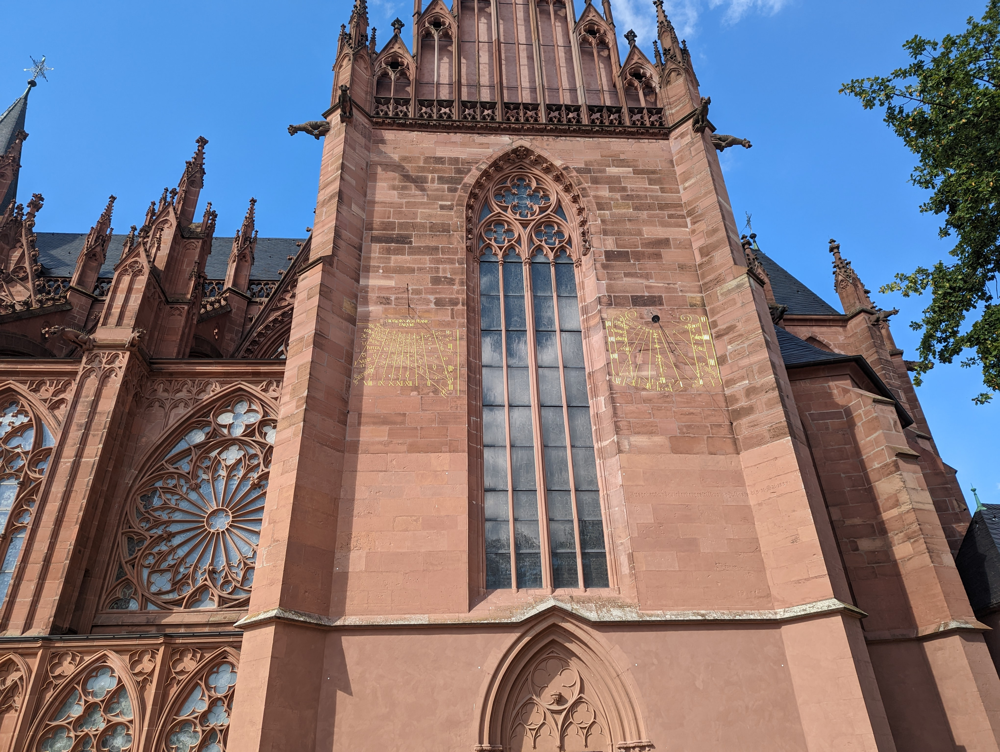

In [13]:
img = Image.open(photos[4])
img

## import civilpy functions

In [2]:
from civilpy.state.ohio.dot import Project
import requests
import json
from bs4 import BeautifulSoup

Couldn't find a dataframe at https://daneparks.com/Dane/civilpy/-/raw/master/res/2022AllRecordsDelimitedAllStates.txt make sure this page is still up


In [3]:
full_data_url = "https://gis.dot.state.oh.us/arcgis/rest/services/TIMS/Projects/MapServer/0/33846832?f=pjson"

page = requests.get(full_data_url)
data_json = json.loads(page.content)

In [4]:
def get_project_data_from_tims(pid='112664'):
    url = f"https://gis.dot.state.oh.us/arcgis/rest/services/TIMS/Projects/MapServer/0/query?where=PID_NBR%3D{pid}&text=&objectIds=&time=&geometry=&geometryType=esriGeometryEnvelope&inSR=&spatialRel=esriSpatialRelIntersects&relationParam=&outFields=&returnGeometry=true&returnTrueCurves=false&maxAllowableOffset=&geometryPrecision=&outSR=&having=&returnIdsOnly=true&returnCountOnly=false&orderByFields=&groupByFieldsForStatistics=&outStatistics=&returnZ=false&returnM=false&gdbVersion=&historicMoment=&returnDistinctValues=false&resultOffset=&resultRecordCount=&queryByDistance=&returnExtentOnly=false&datumTransformation=&parameterValues=&rangeValues=&quantizationParameters=&featureEncoding=esriDefault&f=html"

    page = requests.get(url)
    url_base = 'https://gis.dot.state.oh.us'
    soup = BeautifulSoup(page.content, 'html5lib')

    all_page_links = soup.find_all('a')
    project_point_links = {}
    counter = 0

    for link in all_page_links:
        print(link.text)
        if link.text.isnumeric():
            counter += 1
            full_data_url = url_base + link.get('href') + '?f=pjson'
            print(f"Retrieving data from url at {full_data_url}\n")

            page = requests.get(full_data_url)
            data_json = json.loads(page.content)
            temp = data_json
            
            try:
                extracted_data = data_json['feature']['attributes']
            except:
                return data_json

            project_point_links[link.text] = extracted_data

        else:
            data_json = ''

    project_point_links['no_of_pts'] = counter

    return project_point_links

In [5]:
test = get_project_data_from_tims('112664')
test

Home
services
TIMS
Projects (MapServer)
All Project Points
query
Help
API Reference
34595818
Retrieving data from url at https://gis.dot.state.oh.us/arcgis/rest/services/TIMS/Projects/MapServer/0/34595818?f=pjson

34597747
Retrieving data from url at https://gis.dot.state.oh.us/arcgis/rest/services/TIMS/Projects/MapServer/0/34597747?f=pjson



{'34595818': {'ObjectID': 34595818,
  'GIS_ID': 69759,
  'PID_NBR': 112664,
  'DISTRICT_NBR': 6,
  'LOCALE_SHORT_NME': 'D06',
  'COUNTY_NME': 'District 6',
  'PROJECT_NME': 'D06-FY23 Bridge Repair',
  'CONTRACT_TYPE': 'Standard Build',
  'PRIMARY_FUND_CATEGORY_TXT': 'District Preservation (Pv & Br)',
  'PROJECT_MANAGER_NME': 'PARKS, DANE RICHARD',
  'RESERVOIR_YEAR': None,
  'TIER': None,
  'ODOT_LETTING': 'ODOT Let',
  'SCHEDULE_TYPE_SHORT_NME': 'Standard',
  'ENV_PROJECT_MANAGER_NME': 'GARTNER, JANICE M',
  'AREA_ENGINEER_NME': 'WISE, DANIEL S',
  'PROJECT_ENGINEER_NME': 'FIRIS, BENJAMIN L',
  'DESIGN_AGENCY': 'DISTRICT 6-ENGINEERING',
  'SPONSORING_AGENCY': 'DISTRICT 6-BRIDGES',
  'PDP_SHORT_NAME': 'Path 1',
  'PRIMARY_WORK_CATEGORY': 'Bridge Preservation',
  'PROJECT_STATUS': 'Filed',
  'FISCAL_YEAR': '2023',
  'INHOUSE_DESIGN_FULL_NME': 'BLOOR, CLAYTON  ',
  'EST_TOTAL_CONSTR_COST': 306313.77,
  'STATE_PROJECT_NBR': None,
  'CONSTR_VENDOR_NME': None,
  'STIP_FLAG': None,
  'CURREN

In [6]:
single_dict = test[list(test.keys())[0]]

In [7]:
single_dict

{'ObjectID': 34595818,
 'GIS_ID': 69759,
 'PID_NBR': 112664,
 'DISTRICT_NBR': 6,
 'LOCALE_SHORT_NME': 'D06',
 'COUNTY_NME': 'District 6',
 'PROJECT_NME': 'D06-FY23 Bridge Repair',
 'CONTRACT_TYPE': 'Standard Build',
 'PRIMARY_FUND_CATEGORY_TXT': 'District Preservation (Pv & Br)',
 'PROJECT_MANAGER_NME': 'PARKS, DANE RICHARD',
 'RESERVOIR_YEAR': None,
 'TIER': None,
 'ODOT_LETTING': 'ODOT Let',
 'SCHEDULE_TYPE_SHORT_NME': 'Standard',
 'ENV_PROJECT_MANAGER_NME': 'GARTNER, JANICE M',
 'AREA_ENGINEER_NME': 'WISE, DANIEL S',
 'PROJECT_ENGINEER_NME': 'FIRIS, BENJAMIN L',
 'DESIGN_AGENCY': 'DISTRICT 6-ENGINEERING',
 'SPONSORING_AGENCY': 'DISTRICT 6-BRIDGES',
 'PDP_SHORT_NAME': 'Path 1',
 'PRIMARY_WORK_CATEGORY': 'Bridge Preservation',
 'PROJECT_STATUS': 'Filed',
 'FISCAL_YEAR': '2023',
 'INHOUSE_DESIGN_FULL_NME': 'BLOOR, CLAYTON  ',
 'EST_TOTAL_CONSTR_COST': 306313.77,
 'STATE_PROJECT_NBR': None,
 'CONSTR_VENDOR_NME': None,
 'STIP_FLAG': None,
 'CURRENT_STIP_CO_AMT': None,
 'PROJECT_PLANS_URL

# Connecting to a website in a browser

need to check your browser [version here](edge://settings/help) and download your driver [version here](https://developer.microsoft.com/en-us/microsoft-edge/tools/webdriver/#downloads) (ODOT internal, use the appropriate driver for the browser you like best, like firefox)

In [18]:
import os
import time
from selenium import webdriver
from selenium.webdriver.common.by import By
from selenium.webdriver.support.select import Select
from selenium.webdriver.support.wait import WebDriverWait


import warnings
warnings.filterwarnings('ignore')

driver = webdriver.Edge(r"C:\Users\drpar\Downloads\edge driver\msedgedriver.exe")
driver.get('https://connect.bentley.com')
print(f"Page title: {driver.title}")

Page title: Sign In


Authenticate into bentley's systems, for odot users, first screen is your ODOT email, second; user is your ODOT username/pasword so for me user=`dot/dparks1` password=`hahajk****59`

replace my credentials with the appropriate user's

In [21]:
# Save your credentials as an environment variable (don't send the file with your cred...)
# os.environ["BENTLEYPASSWORD"] = "hahajk****59"

Wait for the page to load, find the sign in and password fields, and attempt to sign in

In [22]:
# Wait until the username box appears, then select it
WebDriverWait(driver, timeout=5).until(lambda d: d.find_element(By.ID, 'identifierInput'))

driver.find_element(By.ID, 'identifierInput').send_keys('dane.parks@dot.ohio.gov')
next_button = driver.find_element(By.ID, "sign-in-button")
next_button.click()

In [23]:
WebDriverWait(driver, timeout=5).until(lambda d: d.find_element(By.ID, 'userNameInput'))
driver.find_element(By.ID, 'userNameInput').send_keys('dot\dparks1')
driver.find_element(By.ID, 'passwordInput').send_keys(os.environ["BENTLEYPASSWORD"])

sign_in_button = driver.find_element(By.ID, 'submitButton')
sign_in_button.click()

## Assetwise sign-in

In [31]:
import os
import time
from selenium import webdriver
from selenium.webdriver.common.by import By
from selenium.webdriver.common.keys import Keys
from selenium.webdriver.support.select import Select
from selenium.webdriver.support.wait import WebDriverWait

import warnings
warnings.filterwarnings('ignore')

driver = webdriver.Edge(r"C:\Users\drpar\Downloads\edge driver\msedgedriver.exe")
driver.get('https://ohiodot-it.bentley.com/login.aspx')
print(f"Page title: {driver.title}")

Page title: Bentley® AssetWise Inspections™


In [32]:
# Wait until the username box appears, then select it
WebDriverWait(driver, timeout=5).until(lambda d: d.find_element(By.ID, 'ContentPlaceHolder1_cmdOIDCLogin'))

IMS_Login = driver.find_element(By.ID, 'ContentPlaceHolder1_cmdOIDCLogin')
IMS_Login.click()

driver.find_element(By.ID, 'identifierInput').send_keys('dane.parks@dot.ohio.gov')
next_button = driver.find_element(By.ID, 'sign-in-button')
next_button.click()

In [33]:
WebDriverWait(driver, timeout=5).until(lambda d: d.find_element(By.ID, 'userNameInput'))
driver.find_element(By.ID, 'userNameInput').send_keys('dot\dparks1')
driver.find_element(By.ID, 'passwordInput').send_keys(os.environ["BENTLEYPASSWORD"])

sign_in_button = driver.find_element(By.ID, 'submitButton')
sign_in_button.click()

In [35]:
WebDriverWait(driver, timeout=5).until(lambda d: d.find_element(By.ID, 'txtQuickSelect'))
driver.find_element(By.ID, 'txtQuickSelect').send_keys('2508559')
driver.find_element(By.ID, 'txtQuickSelect').send_keys(Keys.RETURN)

# Open a Pdf File to a Specific Page (Adobe Reader)

In [8]:
import subprocess
import os

path_to_pdf = os.path.abspath('C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\ODOT_sample_plans.pdf')
# I am testing this on my Windows Install machine
path_to_acrobat = os.path.abspath("C:\\Program Files\\Adobe\\Acrobat DC\\Acrobat\\Acrobat.exe") 

# this will open your document on page 12
process = subprocess.Popen([path_to_acrobat, '/A', 'page=12', path_to_pdf], shell=False, stdout=subprocess.PIPE)
process.wait()

1

# Open a Pdf Page into Memory

# 3D Point Clouds

Working with point clouds in native python is a pain, use [Cloud Compare](https://www.danielgm.net/cc/) if you have to work with a weird format resize, convert or reconfigure youre point cloud data.

[Based on Florent Poux's blog](https://towardsdatascience.com/how-to-automate-3d-point-cloud-segmentation-and-clustering-with-python-343c9039e4f5)

[Creating meshes from clouds](https://towardsdatascience.com/5-step-guide-to-generate-3d-meshes-from-point-clouds-with-python-36bad397d8ba)

QGIS is a good tool for viewing what back end stuff is going on visually.

In [36]:
import numpy as np
import open3d as o3d

input_path = 'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\'
output_path = 'C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\'
dataname = '0617_Cloud.xyz'

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [38]:
point_cloud = np.loadtxt(input_path+dataname, skiprows=1)

In [39]:
import numpy as np
import laspy as lp

file_path = "C:\\Users\\drpar\\PycharmProjects\\civilpy\\res\\0617.laz"

point_cloud=lp.read(file_path)

In [40]:
points = np.vstack((point_cloud.x, point_cloud.y, point_cloud.z)).transpose()
colors = np.vstack((point_cloud.red, point_cloud.green, point_cloud.blue)).transpose()

In [41]:
import pptk

v = pptk.viewer(points)
v.attributes(colors/65535)

preview of resulting image

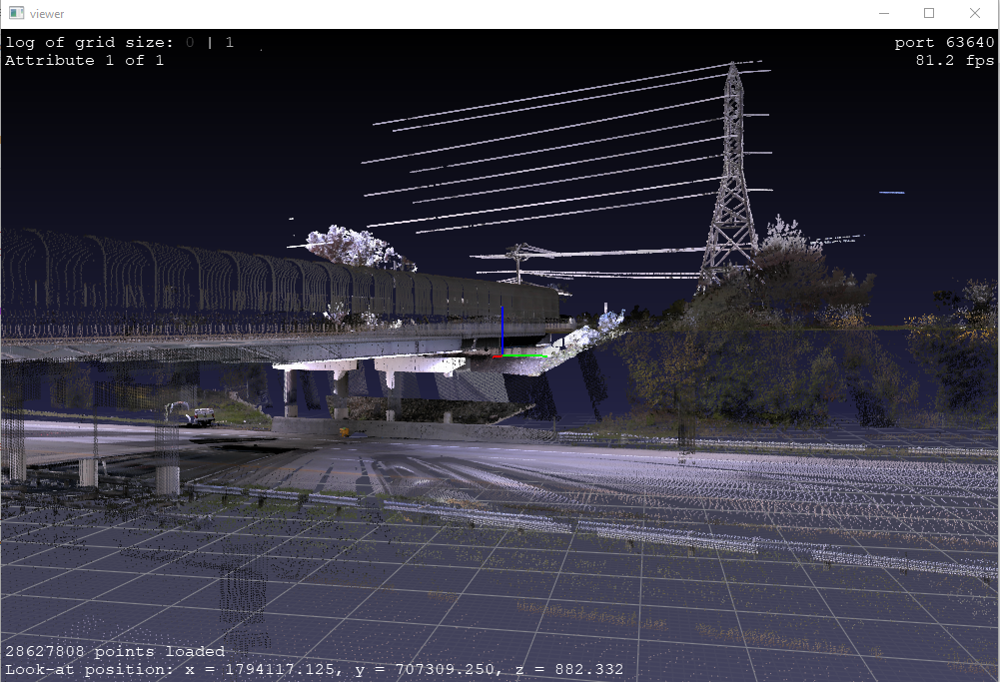

The resulting point cloud has to be refined into usable objects and corrected, some of the tools for visualizing data in various ways are shown.

To make a selection and filter out the data for it (for example a car/truck), go to top view (shortcut `7`) and make a selection by dragging a rectangle selection holding `ctrl` + `LMB`

![selection_demo](https://miro.medium.com/v2/resize:fit:640/1*Hd6oHUq1h4wwS7kvvEI4Rw.gif)

In [8]:
# To get only the tower from a 3D scan
